Installs and imports

Questions
- Possibly have problem of more policing causing higher crime counts because more active?
- Problem of changing district and precint codes over the course of 15 years for finding hot spots


In [ ]:
# Install the necessary libraries
!pip install pandas requests
!pip install ydata-profiling
!pip install sweetviz
!pip install contextily geopandas
!pip install qgrid

# Import libraries
import pandas as pd
import requests
import matplotlib.pyplot as plt
import sweetviz as sv
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import contextily as ctx
import geopandas as gpd
from ydata_profiling import ProfileReport
from IPython.display import clear_output, display, HTML

# Clear the console
clear_output()

Import data - Directly getting data from sql API is too big, so needs to broken into chunks.

In [ ]:
url = 'https://phl.carto.com/api/v2/sql?q=SELECT * FROM incidents_part1_part2 WHERE dispatch_date BETWEEN \'2007-01-01\' AND \'2014-12-31\''

# Send the GET request to download the data
response = requests.get(url)

# Check if the request was successful
if response.status_code == 200:
    # Parse the JSON response
    data = response.json()

    # Load the rows key into a pandas DataFrame
    df1 = pd.DataFrame(data['rows'])
else:
    print(f"Failed to retrieve data. Status code: {response.status_code}")


url = 'https://phl.carto.com/api/v2/sql?q=SELECT * FROM incidents_part1_part2 WHERE dispatch_date BETWEEN \'2015-01-01\' AND \'2022-12-31\''

# Send the GET request to download the data
response = requests.get(url)

# Check if the request was successful
if response.status_code == 200:
    # Parse the JSON response
    data = response.json()

    # Load the rows key into a pandas DataFrame
    df2 = pd.DataFrame(data['rows'])
else:
    print(f"Failed to retrieve data. Status code: {response.status_code}")

df = pd.concat([df1, df2], axis=0)


# Reset the index of daraframe
df.reset_index(drop=True, inplace=True)

Display all featues and list of crimes - [Feature descriptions](https://metadata.phila.gov/#home/datasetdetails/5543868920583086178c4f8e/representationdetails/570e7621c03327dc14f4b68d/?view_287_page=1)

In [ ]:
# Get dataframe features
features = list(df.columns)

print("Features: \n")

# Print the list of features
for feature in features:
    print(feature)

Features: 

cartodb_id
the_geom
the_geom_webmercator
objectid
dc_dist
psa
dispatch_date_time
dispatch_date
dispatch_time
hour
dc_key
location_block
ucr_general
text_general_code
point_x
point_y


---

### Data Import and Special Fields in Carto

The data was imported via **Carto's SQL API**, which added several fields for SQL queries. These fields are specific to Carto and provide additional functionality for data analysis and mapping. Below is an overview of these fields:

- **`cartodb_id`**:  
  A unique identifier automatically added by Carto to provide a unique key for each record. This field does not exist in the original source data.

- **`the_geom`**:  
  A geometry field used for spatial queries and analysis. While powerful, queries involving this field can be more verbose than other field types and may require more explanation.

- **`the_geom_webmercator`**:  
  A special field automatically added by Carto to optimize the rendering of map tiles for mapping services. It contains the same information as the `the_geom` field but is projected in the **Web Mercator** coordinate system (EPSG:3857), which is commonly used for web mapping.

---


| Field Name           | Alias                   | Description                                                                                     | Type       |
|----------------------|-------------------------|-------------------------------------------------------------------------------------------------|------------|
| DC_Dist              | District                | A two character field that names the District boundary.                                          | Text       |
| DC_Key               | DC Number               | The unique identifier of the crime that consists of Year + District + Unique ID.                 | Text       |
| DISPATCH_DATE        | Dispatch Date           | Dispatch date formatted as a string                                                             | Text       |
| Dispatch_Date_Time   | Dispatch Date/Time      | The date and time that the officer was dispatched to the scene.                                  | Date/Time  |
| DISPATCH_TIME        | Dispatch Time           | Dispatch time formatted as a string                                                             | Text       |
| HOUR_                | Hour                    | The generalized hour of the dispatched time.                                                    | Numeric    |
| Location_Block       | Location Block          | The location of crime generalized by street block.                                               | Text       |
| OBJECTID             | ObjectID                |                                                                                                 | OBJECTID   |
| Point_X              |                         | Longitude of crime location.                                                                    | Text       |
| Point_Y              |                         | Latitude of crime location.                                                                     | Numeric    |
| PSA                  | PSA                     | A single character field that names the Police Service Area boundary.                            | Text       |
| SHAPE                | Shape                   | Point geometry                                                                                  | Geometry   |
| Text_General_Code    | General Crime Category  | The generalized text for the crime code.                                                        | Text       |
| UCR_General          | UCR (Crime) Code        | The rounded crime code. Part I (Violent) Crimes: 100-799, Part 2 Crimes: 800-2600                | Numeric    |


Select only the violent crimes(ucr_codes under 800)

In [ ]:
print("Original Dataframe size:",len(df))

# Get dataframe for only violent criems(UCR codes under 800)
df['ucr_general']= df['ucr_general'].astype(int)
df= df[df['ucr_general'] < 800]

print("Violent Crime Dataframe size:",len(df))

Original Dataframe size: 2783492
Violent Crime Dataframe size: 1090720


In [ ]:
# Get dataset summary and statistics
profile = ProfileReport(df, title="Profiling Violent Crime Dataset Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

                                             |          | [  0%]   00:00 -> (? left)

Report sweetviz_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



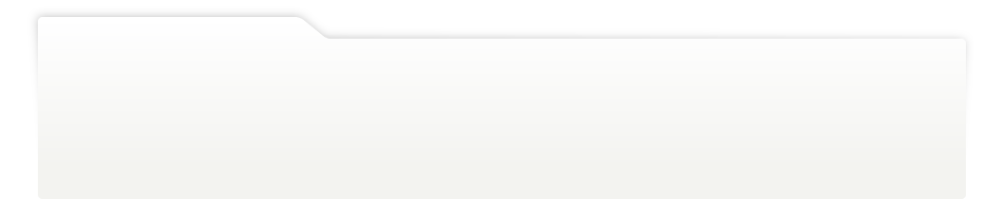
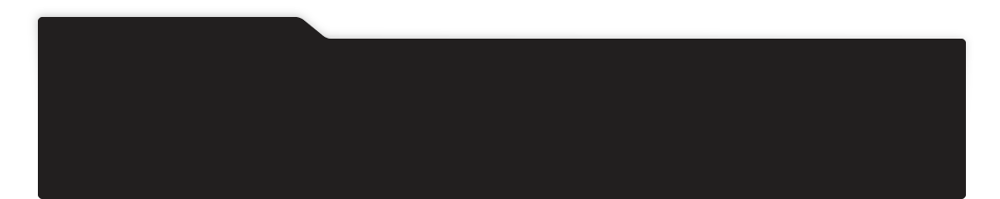
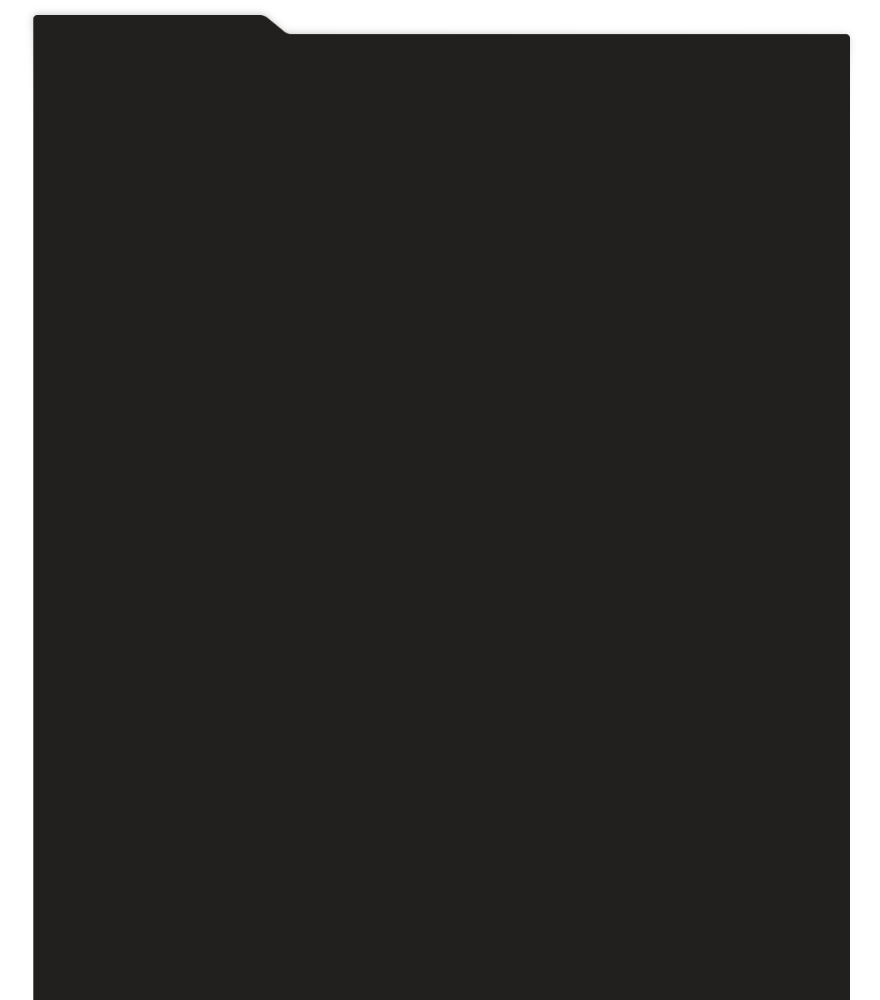
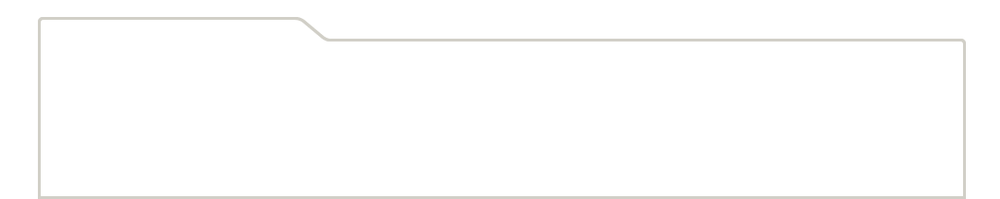
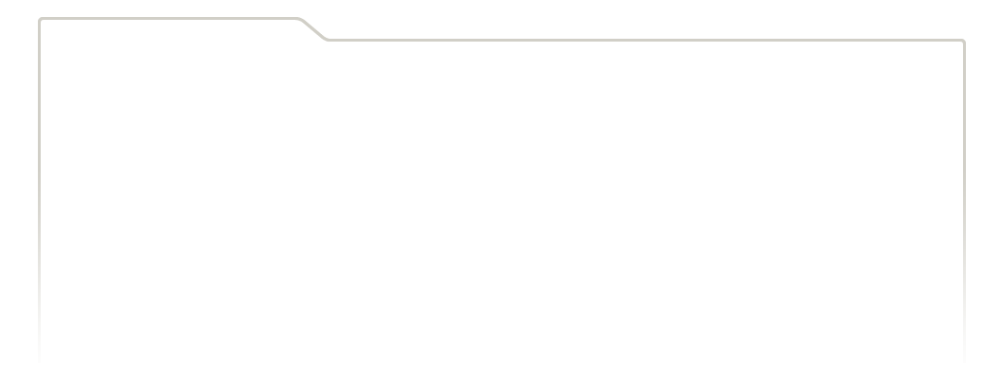
...
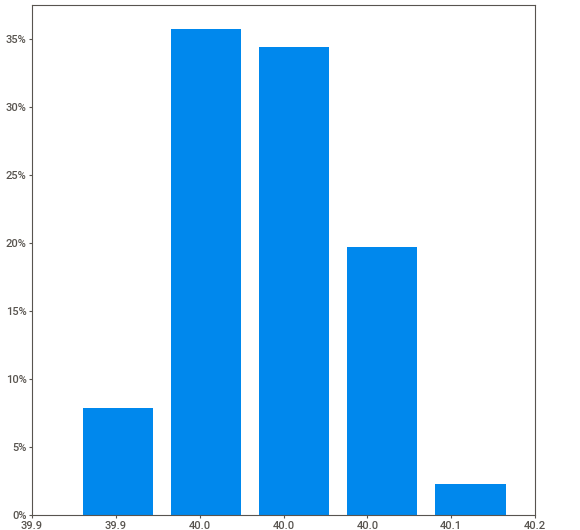
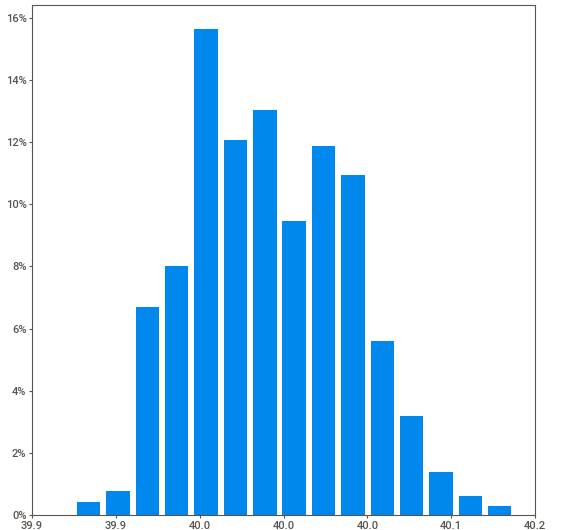
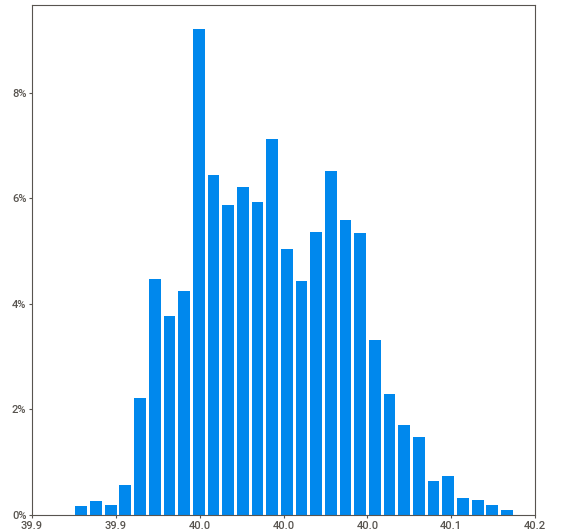
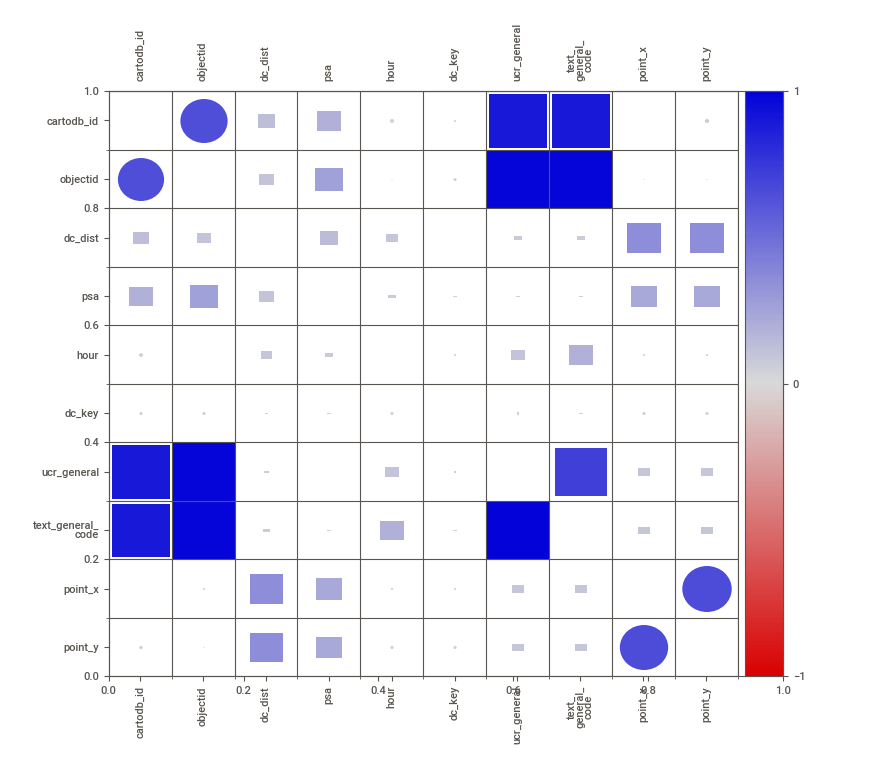
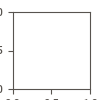

In [ ]:
# Analyze the DataFrame
my_report = sv.analyze(df)

# Save the report as an HTML file
my_report.show_html(filepath='sweetviz_report.html')

# Open the HTML report directly in the notebook
with open('sweetviz_report.html', 'r') as f:
    html_content = f.read()

# Display the HTML content in Colab
display(HTML(html_content))


In [ ]:
# Remove features that are not used
df = df.drop(columns=['cartodb_id','dispatch_date_time','dispatch_time','hour','objectid','dc_key'])

# Display the first 5 rows of the DataFrame in an interactive grid
df.head().style

,the_geom,the_geom_webmercator,dc_dist,psa,dispatch_date,location_block,ucr_general,text_general_code,point_x,point_y
0,0101000020E610000017429450F6D052C00C1997C3D1FC4340,0101000020110F0000A3F89A4F18F65FC17B0D2F015F8C5241,19,1,2011-09-27,7500 BLOCK WOODCREST AV,600,Theft from Vehicle,-75.265034,39.975151
1,0101000020E610000013038F3544D152C04F9CB3709FFC4340,0101000020110F00004C9D5D9F9CF65FC11B5B803B278C5241,19,1,2011-12-18,7700 BLOCK WOODBINE AVE,400,Aggravated Assault Firearm,-75.269788,39.973616
2,0101000020E61000008E068DEC0CBF52C0A02FA46099064440,0101000020110F000007393990ABD75FC1CA5AEA4237975241,08,2,2011-07-13,9500 BLOCK STATE RD,600,Theft from Vehicle,-74.985164,40.051556
3,0101000020E6100000BCDA9B293EBF52C08F64E2985D064440,0101000020110F0000ABCE2E33FFD75FC11E8D4DEFF4965241,08,2,2011-09-14,9500 BLOCK STATE RD,500,Burglary Residential,-74.988169,40.049731
4,0101000020E6100000418FC5F4CCC852C005FF957418044440,0101000020110F0000690139533BE85FC1EEF8323F70945241,35,2,2011-09-15,800 BLOCK W WELLENS ST,400,Aggravated Assault No Firearm,-75.137510,40.031996


In [ ]:
# Convert the date
df['dispatch_date'] = pd.to_datetime(df['dispatch_date'], format='%Y-%m-%d')

# Loop through the years from 2007 to 2022 and create dataframe for each year
for year in range(2007, 2023):
    # Create a string for the variable name dynamically
    globals()[f'df_{year}'] = df[(df['dispatch_date'] >= f'{year}-01-01') & (df['dispatch_date'] <= f'{year}-12-31')]



The first initiative (2010-2012) was to conduct a test the effectiveness of three policing strategies; foot patrol, problem-solving, and an offender-focused strategy. The second initiative (2012-2014) incorporated the lessons learned from the first initiative, and moved from randomized experiments to an organizational change model. Philadelphia SPI's third initiative (2014-2017) continued efforts to integrate Smart Policing and analytics through the Philadelphia Police Department through use of the hypothesis testing approach. - https://www.smart-policing.com/spi-sites/philadelphia-pennsylvania-2014

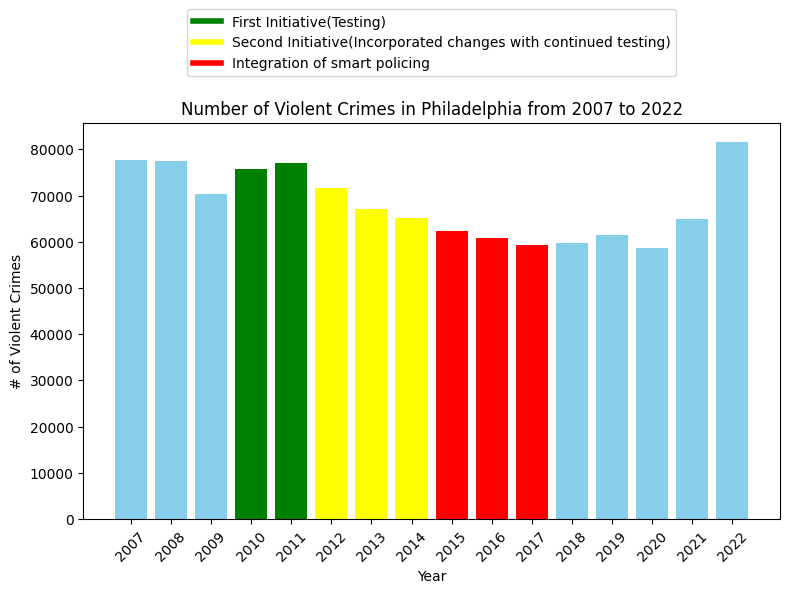

In [ ]:
# List to store the sizes of each dataframe
sizes = []

# Loop through the years and calculate the size (number of rows) for each year
years = range(2007, 2023)
for year in years:
    sizes.append(len(globals()[f'df_{year}']))

# Create a list of colors for histogram
colors = [
    'green' if 2010 <= year <= 2011 else
    'yellow' if 2012 <= year <= 2014 else
    'red' if 2015 <= year <= 2017 else
    'skyblue'  # Default color for other years
    for year in years
]

# Plot the histogram with specified colors
plt.figure(figsize=(8, 5))
plt.bar(years, sizes, color=colors)
plt.title('Number of Violent Crimes in Philadelphia from 2007 to 2022')
plt.xlabel('Year')
plt.ylabel('# of Violent Crimes')
plt.xticks(years, rotation=45)
plt.tight_layout()

# Create a custom legend for the colors
legend_elements = [
    plt.Line2D([0], [0], color='green', lw=4, label='First Initiative(Testing)'),
    plt.Line2D([0], [0], color='yellow', lw=4, label='Second Initiative(Incorporated changes with continued testing)'),
    plt.Line2D([0], [0], color='red', lw=4, label='Integration of smart policing'),
]


plt.legend(handles=legend_elements, loc='lower center', bbox_to_anchor=(0.5, 1.1), fontsize=10, ncol=1)
plt.subplots_adjust(top=0.95)
plt.show()

In [ ]:
# Create year column
df['year'] = pd.to_datetime(df['dispatch_date']).dt.year

# Group the data by year and dc_dist counting occurrences
grouped = df.groupby(['year', 'dc_dist']).size().reset_index(name='count')

# Create 2D array
pivot_table = grouped.pivot(index='year', columns='dc_dist', values='count').fillna(0)

# Display the table
pivot_table.style.set_caption("Incident Count by Year and District").background_gradient(cmap='gray')

dc_dist,01,02,03,04,05,06,07,08,09,12,14,15,16,17,18,19,22,23,24,25,26,35,39,77,92
year,,,,,,,,,,,,,,,,,,,,,,,,,
2007,1735.000000,3920.000000,1590.000000,2682.000000,1319.000000,4402.000000,1710.000000,3231.000000,3958.000000,4485.000000,4508.000000,5850.000000,2040.000000,2592.000000,4417.000000,3733.000000,2716.000000,2060.000000,4788.000000,4646.000000,2825.000000,4361.000000,3377.000000,473.000000,347.000000
2008,1581.000000,3991.000000,1792.000000,2643.000000,1234.000000,4550.000000,1688.000000,3011.000000,3927.000000,4126.000000,4338.000000,6460.000000,2166.000000,2566.000000,4710.000000,3681.000000,2919.000000,2028.000000,4463.000000,4384.000000,3078.000000,4328.000000,3123.000000,430.000000,354.000000
2009,1428.000000,3797.000000,1550.000000,2713.000000,1024.000000,3915.000000,1838.000000,2831.000000,3546.000000,3316.000000,4017.000000,5975.000000,2047.000000,2144.000000,3877.000000,3354.000000,2647.000000,1744.000000,4461.000000,3978.000000,3121.000000,3823.000000,2764.000000,317.000000,28.000000
2010,1715.000000,4132.000000,4197.000000,392.000000,1016.000000,4364.000000,1782.000000,2822.000000,4049.000000,3553.000000,3924.000000,6634.000000,2128.000000,2238.000000,3840.000000,3633.000000,5074.000000,22.000000,4773.000000,4261.000000,3352.000000,4153.000000,3286.000000,312.000000,0.000000
2011,1704.000000,4709.000000,4441.000000,0.000000,1148.000000,4225.000000,1862.000000,3218.000000,4100.000000,3974.000000,4101.000000,6989.000000,2161.000000,2310.000000,3686.000000,3415.000000,4979.000000,0.000000,4718.000000,4042.000000,3600.000000,4110.000000,3198.000000,354.000000,0.000000
2012,1578.000000,4132.000000,4058.000000,0.000000,1209.000000,4050.000000,1751.000000,2914.000000,3568.000000,3497.000000,3937.000000,6043.000000,1866.000000,2159.000000,3537.000000,3305.000000,4925.000000,0.000000,4570.000000,3866.000000,3312.000000,3724.000000,3296.000000,283.000000,0.000000
2013,1369.000000,3954.000000,3824.000000,0.000000,1107.000000,3499.000000,1682.000000,2458.000000,3407.000000,3556.000000,3558.000000,5427.000000,1866.000000,2070.000000,3528.000000,3196.000000,4650.000000,1.000000,4149.000000,3641.000000,3056.000000,3786.000000,2940.000000,292.000000,0.000000
2014,1236.000000,3895.000000,3601.000000,0.000000,1001.000000,3172.000000,1674.000000,2444.000000,3123.000000,3605.000000,3479.000000,5356.000000,1944.000000,1818.000000,3434.000000,3359.000000,4736.000000,0.000000,3981.000000,3624.000000,2804.000000,3443.000000,3074.000000,357.000000,0.000000
2015,1383.000000,3544.000000,3228.000000,0.000000,834.000000,3340.000000,1551.000000,2204.000000,2804.000000,3350.000000,3523.000000,5353.000000,1841.000000,1823.000000,3302.000000,3227.000000,4582.000000,0.000000,3674.000000,3405.000000,2639.000000,3405.000000,2826.000000,403.000000,0.000000


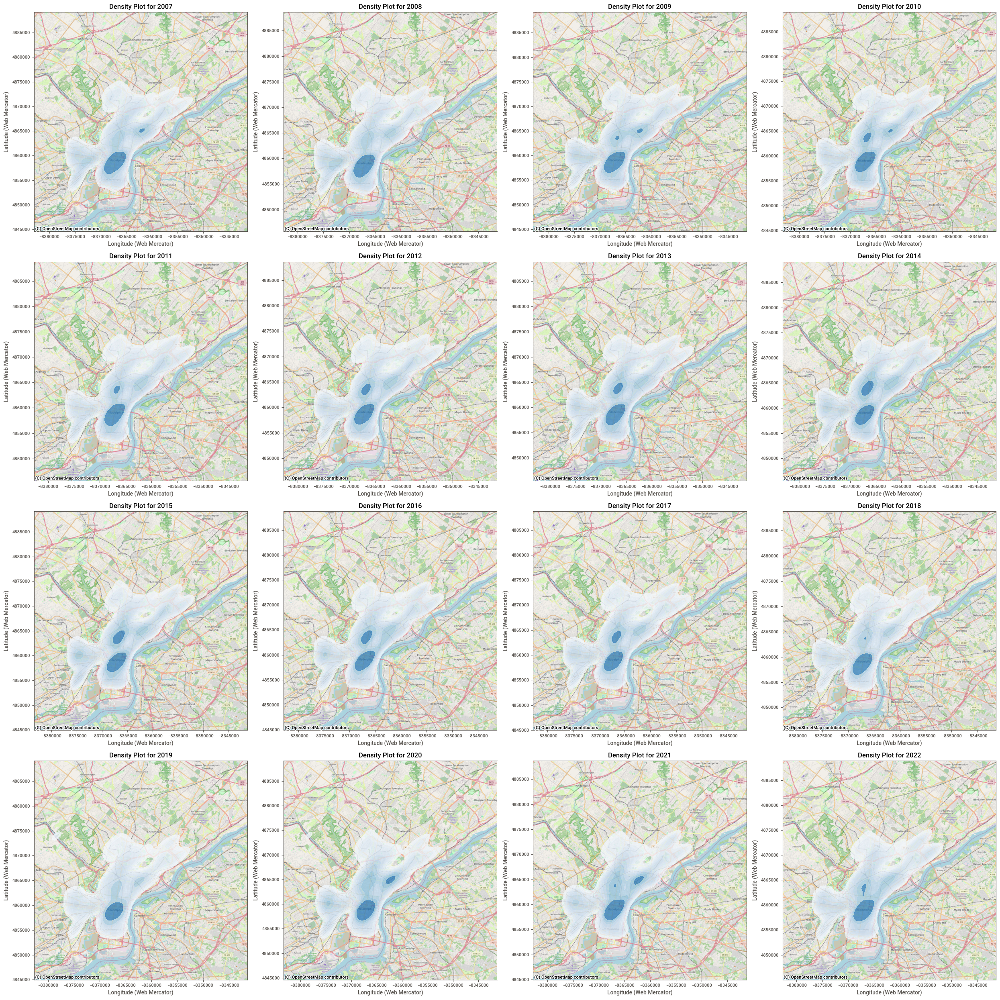

In [ ]:
# Get list of unique years from the dataset
unique_years = sorted(df['year'].unique())

# Set up plot size and layout
plt.figure(figsize=(25, 25))

# Create density plot for each year
for i, year in enumerate(unique_years):
    plt.subplot(4, 4, i+1)
    df_year = df[df['year'] == year]

    # Create a GeoDataFrame
    gdf = gpd.GeoDataFrame(df_year, geometry=gpd.GeoSeries.from_wkb(df_year['the_geom_webmercator']))

    # Create a density plot
    sns.kdeplot(x=gdf.geometry.x, y=gdf.geometry.y, fill=True, cmap="Blues", thresh=0.25, alpha=0.75)

    # Add basemap with contextily OpenStreetMap provider
    ctx.add_basemap(plt.gca(), source=ctx.providers.OpenStreetMap.Mapnik, zoom=12)

    # Add titles and labels
    plt.title(f"Density Plot for {year}")
    plt.xlabel('Longitude (Web Mercator)')
    plt.ylabel('Latitude (Web Mercator)')

plt.tight_layout()
plt.show()
